# Simple DCGAN

In [1]:
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision
import torchvision.transforms as transforms
import matplotlib.pyplot as plt
import numpy as np
import os


In [2]:
# Hyperparameters
batch_size = 128
image_size = 64  # DCGAN typically uses 64x64 images
nz = 100         # Size of the latent vector (input to generator)
ngf = 64         # Generator feature map size
ndf = 64         # Discriminator feature map size
num_epochs = 25
lr = 0.0002
beta1 = 0.5      # Beta1 hyperparam for Adam optimizers


In [3]:
# Create the dataset
transform = transforms.Compose([
    transforms.Resize(image_size),
    transforms.CenterCrop(image_size),
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),  # Normalize to [-1, 1]
])

# Download and create datasets
dataset = torchvision.datasets.CIFAR10(root='./data', download=True, transform=transform)

# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers=2)


100%|███████████████████████████████████████████████████████████████| 170498071/170498071 [00:10<00:00, 16905115.60it/s]


Extracting ./data/cifar-10-python.tar.gz to ./data


In [4]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)


In [5]:
class Generator(nn.Module):
    def __init__(self, nz, ngf, nc=3):
        super(Generator, self).__init__()
        self.main = nn.Sequential(
            # Input: Z latent vector
            nn.ConvTranspose2d(nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # State: (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # State: (ngf*4) x 8 x 8
            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # State: (ngf*2) x 16 x 16
            nn.ConvTranspose2d(ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # State: (ngf) x 32 x 32
            nn.ConvTranspose2d(ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # Output: (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)


In [6]:
class Discriminator(nn.Module):
    def __init__(self, ndf, nc=3):
        super(Discriminator, self).__init__()
        self.main = nn.Sequential(
            # Input: (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # State: (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # State: (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # State: (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # State: (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
            # Output: Scalar probability
        )

    def forward(self, input):
        return self.main(input)


In [7]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# Create the generator
netG = Generator(nz, ngf).to(device)
netG.apply(weights_init)
print(netG)

# Create the discriminator
netD = Discriminator(ndf).to(device)
netD.apply(weights_init)
print(netD)


Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [8]:
# Binary Cross Entropy loss
criterion = nn.BCELoss()

# Create fixed noise for generating samples
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Labels
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))


In [10]:
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
for epoch in range(num_epochs):
    for i, data in enumerate(dataloader, 0):
        ############################
        # (1) Update D network
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        real_images = data[0].to(device)
        b_size = real_images.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        
        output = netD(real_images).view(-1)
        errD_real = criterion(output, label)
        errD_real.backward()
        D_x = output.mean().item()
        
        ## Train with all-fake batch
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        fake = netG(noise)
        label.fill_(fake_label)
        
        output = netD(fake.detach()).view(-1)
        errD_fake = criterion(output, label)
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        
        errD = errD_real + errD_fake
        optimizerD.step()
        
        ############################
        # (2) Update G network
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # Fake labels are real for generator cost
        output = netD(fake).view(-1)
        errG = criterion(output, label)
        errG.backward()
        D_G_z2 = output.mean().item()
        optimizerG.step()
        
        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())
        
        # Output training stats
        if i % 100 == 0:
            print(f'[{epoch+1}/{num_epochs}][{i}/{len(dataloader)}] '
                  f'Loss_D: {errD.item():.4f} '
                  f'Loss_G: {errG.item():.4f} '
                  f'D(x): {D_x:.4f} '
                  f'D(G(z)): {D_G_z1:.4f} / {D_G_z2:.4f}')
        
        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(torchvision.utils.make_grid(fake, padding=2, normalize=True))
        
        iters += 1


Starting Training Loop...
[1/25][0/391] Loss_D: 1.2736 Loss_G: 4.7266 D(x): 0.4990 D(G(z)): 0.3361 / 0.0127
[1/25][100/391] Loss_D: 0.9868 Loss_G: 3.9272 D(x): 0.5743 D(G(z)): 0.0249 / 0.0262
[1/25][200/391] Loss_D: 0.1257 Loss_G: 6.1715 D(x): 0.9668 D(G(z)): 0.0785 / 0.0044
[1/25][300/391] Loss_D: 0.3596 Loss_G: 3.7981 D(x): 0.8198 D(G(z)): 0.0976 / 0.0321
[2/25][0/391] Loss_D: 0.5011 Loss_G: 4.3789 D(x): 0.8246 D(G(z)): 0.2199 / 0.0197
[2/25][100/391] Loss_D: 0.3793 Loss_G: 3.8584 D(x): 0.7972 D(G(z)): 0.1048 / 0.0280
[2/25][200/391] Loss_D: 0.4479 Loss_G: 6.3360 D(x): 0.9673 D(G(z)): 0.2969 / 0.0034
[2/25][300/391] Loss_D: 0.3784 Loss_G: 3.2361 D(x): 0.8146 D(G(z)): 0.1376 / 0.0523
[3/25][0/391] Loss_D: 0.8673 Loss_G: 1.8418 D(x): 0.5261 D(G(z)): 0.0431 / 0.2108
[3/25][100/391] Loss_D: 0.5736 Loss_G: 3.0853 D(x): 0.8642 D(G(z)): 0.3132 / 0.0642
[3/25][200/391] Loss_D: 0.4515 Loss_G: 2.8713 D(x): 0.7387 D(G(z)): 0.0988 / 0.0868
[3/25][300/391] Loss_D: 0.5637 Loss_G: 2.7900 D(x): 0.76

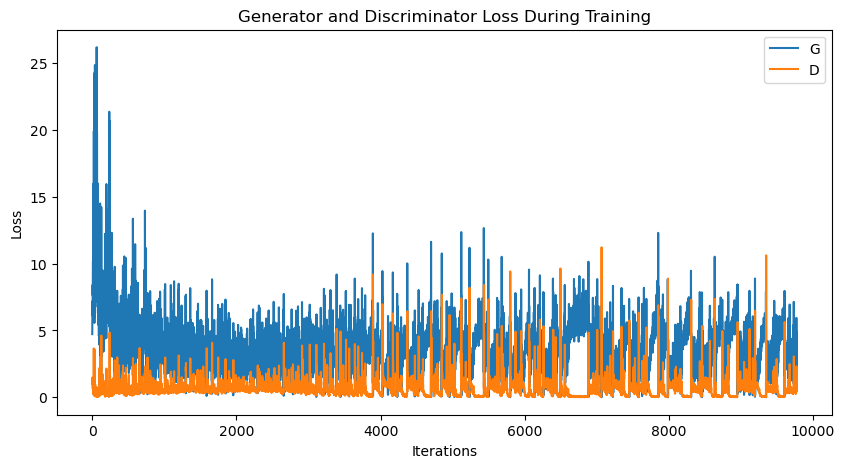

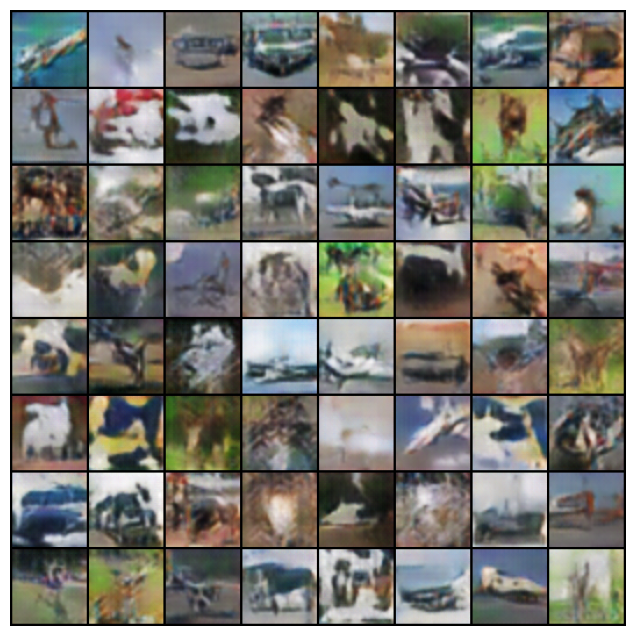

In [12]:
# Plot the training losses
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses, label="G")
plt.plot(D_losses, label="D")
plt.xlabel("Iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

# Display generated images
import matplotlib.animation as animation
from IPython.display import HTML

fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i, (1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

# To display in Jupyter Notebook, uncomment the following line:
HTML(ani.to_jshtml())

# To save the animation as a GIF, uncomment the following lines:
# ani.save('dcgan_training.gif', writer='imagemagick')


In [13]:
# Create a directory to save models
os.makedirs('models', exist_ok=True)

# Save the generator and discriminator
torch.save(netG.state_dict(), 'models/generator.pth')
torch.save(netD.state_dict(), 'models/discriminator.pth')


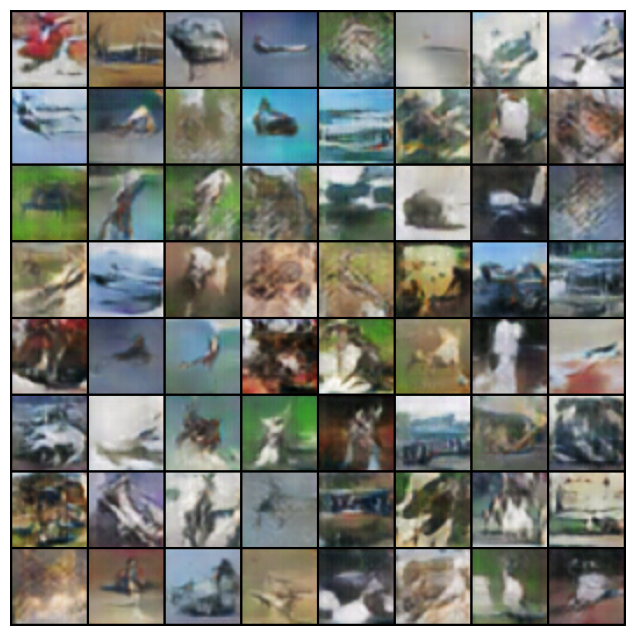

In [15]:
# Load the generator
netG = Generator(nz, ngf).to(device)
netG.load_state_dict(torch.load('models/generator.pth'))
netG.eval()

# Generate new images
with torch.no_grad():
    noise = torch.randn(64, nz, 1, 1, device=device)
    fake_images = netG(noise).detach().cpu()

# Create a grid of generated images
grid = torchvision.utils.make_grid(fake_images, padding=2, normalize=True)

# Display the grid
plt.figure(figsize=(8,8))
plt.axis("off")
plt.imshow(np.transpose(grid, (1,2,0)))
plt.show()
